<a href="https://colab.research.google.com/github/dannymensah26/CVCapstoneProject/blob/main/Grocery_Product_Detection_YoloV8.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import numpy as np

#### **Install and Import Required Libraries**

In [ ]:
# Install Essential Libraries
!pip install ultralytics

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 41.3/41.3 kB 2.5 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl.metadata (1.5 kB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl.metadata (1.6 kB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.

<div class="alert alert-info" style="background-color:#0000FF; color:white; padding:0px 10px; border-radius:5px;">
    <h2 style='margin:10px 5px'> Step 1 | Setup and Initialization </h2>
</div>



In [ ]:
# Disable warnings in the notebook to maintain clean output cells
import warnings
warnings.filterwarnings('ignore')

# Import necessary libraries
import os
import random
import pandas as pd
from PIL import Image
import shutil
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
import yaml
from PIL import Image
from ultralytics import YOLO
from IPython.display import Video

In [ ]:
## Configure the visual appearance of Seaborn plots
sns.set(rc={'axes.facecolor': '#eae8fa'}, style='darkgrid')

### **Step | 1.1 Dataset**
Show Original Images Before Detect From TrainSet

In [ ]:
from google.colab import drive
import pandas as pd

# Assuming `new_train_df` and `new_test_df` are your DataFrames
# Mount Google Drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Path to the image file
image_path = "/content/drive/My Drive/grozzy/train/images"

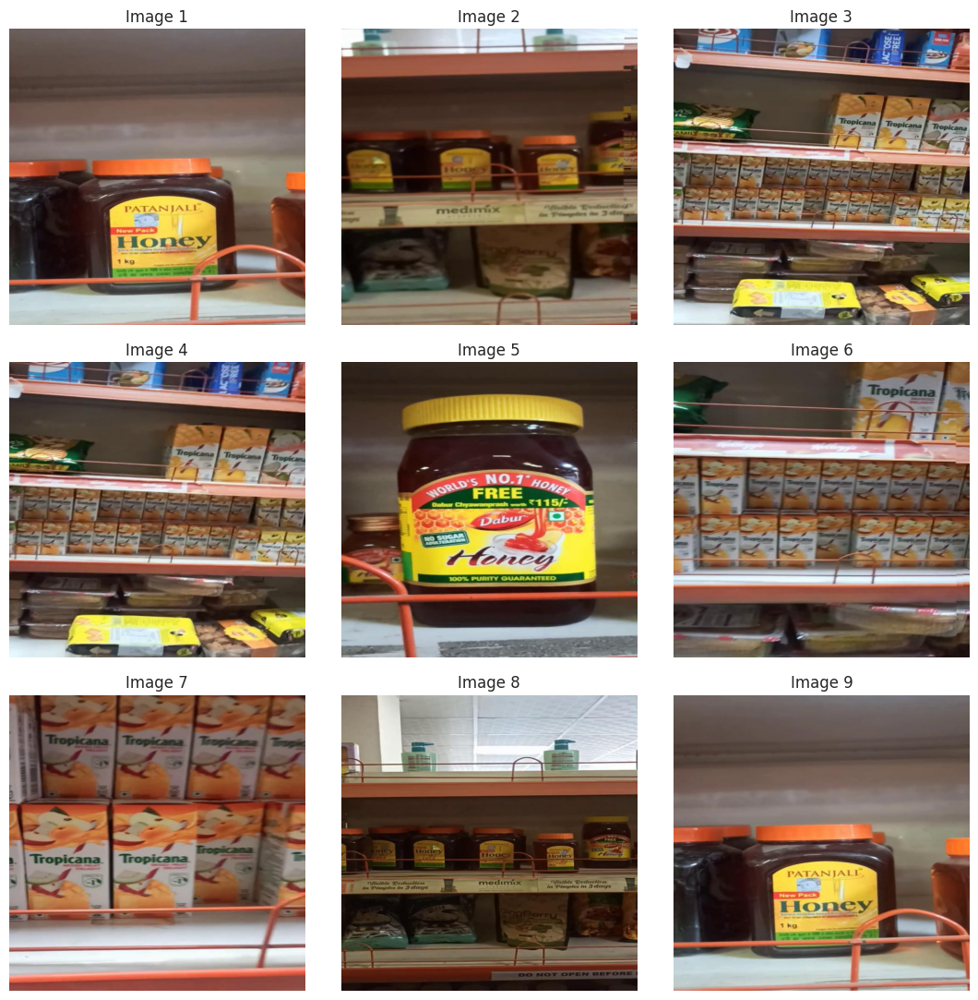

In [ ]:
num_samples = 9
# Get the list of image files in the directory
image_files = os.listdir(image_path)

# Randomly select num_samples images
rand_images = random.sample(image_files, num_samples)

fig, axes = plt.subplots(3, 3, figsize=(11, 11))

for i in range(num_samples):
    image = rand_images[i]
    ax = axes[i // 3, i % 3]
    ax.imshow(plt.imread(os.path.join(image_path, image)))
    ax.set_title(f'Image {i+1}')
    ax.axis('off')

plt.tight_layout()
plt.show()

#### **Step 1.2 |  Get Shape Of An Image For Using In Training Set**

In [ ]:
# Get the size of the image
image = cv2.imread("/content/drive/My Drive/grozzy/sample_image.jpg")
h, w, c = image.shape
print(f"The image has dimensions {w}x{h} and {c} channels.")

The image has dimensions 640x640 and 3 channels.


<div class="alert alert-info" style="background-color:#0000FF; color:white; padding:0px 10px; border-radius:5px;">
    <h2 style='margin:10px 5px'> Step 2 | Loading YOLOv8 Pre-trained Model </h2>
</div>

In [ ]:
# Load a pretrained YOLOv8n model from Ultralytics
model = YOLO('yolov8n.pt')

100%|██████████| 6.25M/6.25M [00:00<00:00, 111MB/s]


In [ ]:
from google.colab import drive
import pandas as pd

# Assuming `new_train_df` and `new_test_df` are your DataFrames
# Mount Google Drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Path to the image file
image_path = "/content/drive/My Drive/grozzy/sample_image.jpg"


image 1/1 /content/drive/My Drive/grozzy/sample_image.jpg: 640x640 (no detections), 7.8ms
Speed: 5.8ms preprocess, 7.8ms inference, 104.6ms postprocess per image at shape (1, 3, 640, 640)


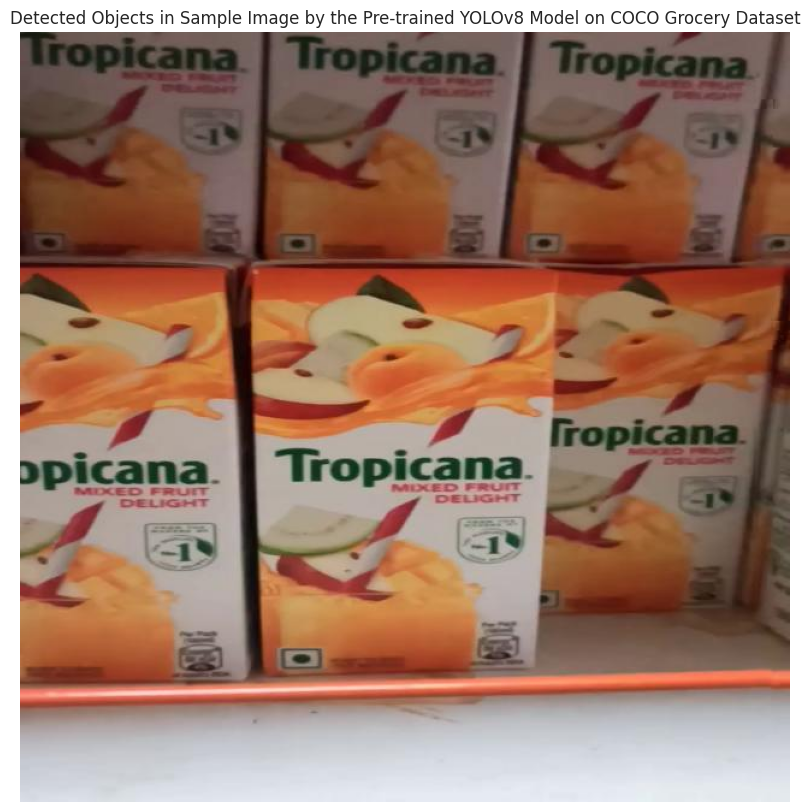

In [ ]:
# Perform inference on the provided image(s)
results = model.predict(source=image_path,
                        imgsz=640,  # Resize image to 640x640 (the size pf images the model was trained on)
                        conf=0.5)   # Confidence threshold: 50% (only detections above 50% confidence will be considered)

# Annotate and convert image to numpy array
sample_image = results[0].plot(line_width=2)

# Convert the color of the image from BGR to RGB for correct color representation in matplotlib
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)

# Display annotated image
plt.figure(figsize=(12,10))
plt.imshow(sample_image)
plt.title('Detected Objects in Sample Image by the Pre-trained YOLOv8 Model on COCO Grocery Dataset', fontsize=12)
plt.axis('off')
plt.show()

<div class="alert alert-info" style="background-color:#0000FF; color:white; padding:0px 10px; border-radius:5px;">
    <h2 style='margin:10px 5px'> Step 3 | Dataset Exploration </h2>
</div>

#### **Step 3.1 | Contents of the YAML File**

In [ ]:
# Define the dataset_path
dataset_path = "/content/drive/My Drive/grozzy"
#dataset_path = r"C:\Users\daniel mensah\Desktop\Seneca College\Seneca final admission\Summer_Semester\Computer Vision_AIG 210\Project Proposal\models\YOLO\data\Groceries"

# Set the path to the YAML file
yaml_file_path = os.path.join(dataset_path, 'data.yaml')

# Load and print the contents of the YAML file
with open(yaml_file_path, 'r') as file:
    yaml_content = yaml.load(file, Loader=yaml.FullLoader)
    print(yaml.dump(yaml_content, default_flow_style=False))

names:
- Dabur Honey 2kg
- Dabur Honey 50gm
- Patanjali Honey 1kg
- Patanjali Honey 500g
- tropicana 100ml
- tropicana 1L
nc: 6
roboflow:
  license: CC BY 4.0
  project: size_detection
  url: https://universe.roboflow.com/marioc-gold/size_detection/dataset/2
  version: 2
  workspace: marioc-gold
test: ../test/images
train: ../train/images
val: ../valid/images



#### **Step 3.2 | Count of Images in Training and Validation Sets**

Now, let's continue our exploration by counting the images in both the training and validation sets and verifying their sizes:

In [ ]:
# Set paths for training and validation image sets
train_images_path = os.path.join(dataset_path, 'train', 'images')
valid_images_path = os.path.join(dataset_path, 'valid', 'images')

# Initialize counters for the number of images
num_train_images = 0
num_valid_images = 0

# Initialize sets to hold the unique sizes of images
train_image_sizes = set()
valid_image_sizes = set()

# Check train images sizes and count
for filename in os.listdir(train_images_path):
    if filename.endswith('.jpg'):
        num_train_images += 1
        image_path = os.path.join(train_images_path, filename)
        with Image.open(image_path) as img:
            train_image_sizes.add(img.size)

# Check validation images sizes and count
for filename in os.listdir(valid_images_path):
    if filename.endswith('.jpg'):
        num_valid_images += 1
        image_path = os.path.join(valid_images_path, filename)
        with Image.open(image_path) as img:
            valid_image_sizes.add(img.size)

# Print the results
print(f"Number of training images: {num_train_images}")
print(f"Number of validation images: {num_valid_images}")

# Check if all images in training set have the same size
if len(train_image_sizes) == 1:
    print(f"All training images have the same size: {train_image_sizes.pop()}")
else:
    print("Training images have varying sizes.")

# Check if all images in validation set have the same size
if len(valid_image_sizes) == 1:
    print(f"All validation images have the same size: {valid_image_sizes.pop()}")
else:
    print("Validation images have varying sizes.")

Number of training images: 510
Number of validation images: 145
All training images have the same size: (640, 640)
All validation images have the same size: (640, 640)


#### **Step 3.3 | Dataset Analysis Insights**

Let's take a look at a few images from the training dataset to get a sense of what the data looks like:

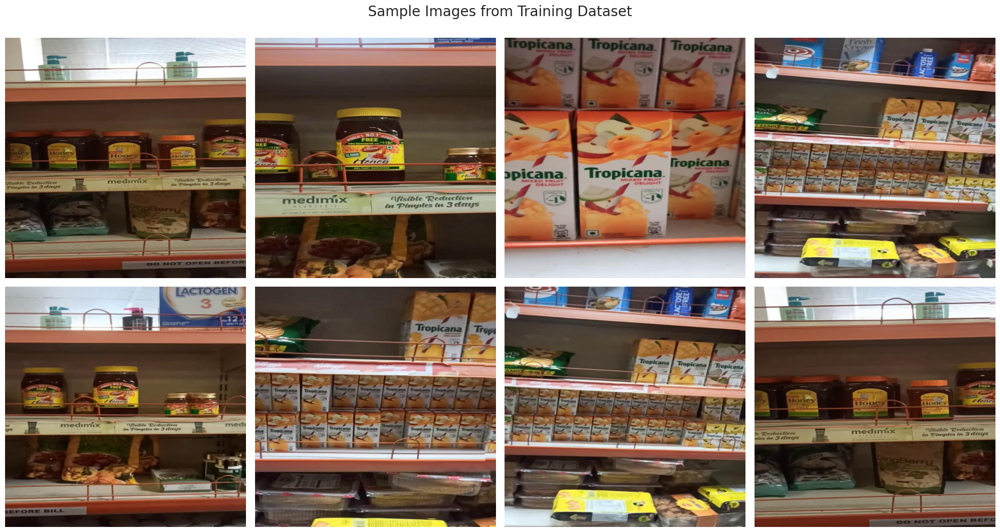

In [ ]:
# List all jpg images in the directory
image_files = [file for file in os.listdir(train_images_path) if file.endswith('.jpg')]

# Select 8 images at equal intervals
num_images = len(image_files)
selected_images = [image_files[i] for i in range(0, num_images, num_images // 8)]

# Create a 2x4 subplot
fig, axes = plt.subplots(2, 4, figsize=(20, 11))

# Display each of the selected images
for ax, img_file in zip(axes.ravel(), selected_images):
    img_path = os.path.join(train_images_path, img_file)
    image = Image.open(img_path)
    ax.imshow(image)
    ax.axis('off')

plt.suptitle('Sample Images from Training Dataset', fontsize=20)
plt.tight_layout()
plt.show()

<div class="alert alert-info" style="background-color:#0000FF; color:white; padding:0px 10px; border-radius:5px;">
    <h2 style='margin:10px 5px'> Step 4 | Fine-Tuning YOLOv8  </h2>
</div>

Fine-tune the YOLOv8 pre-trained object detection model using transfer learning, specifically tailoring it to our 'Grocery Product Detection Image Dataset'. By leveraging the YOLOv8 model's existing weights from its training on the comprehensive COCO dataset, we start from a robust foundation rather than from scratch.

#### **Step 4.1 | Model Training**

In [ ]:
# Train the model on our custom dataset
results = model.train(
    data=yaml_file_path,     # Path to the dataset configuration file
    epochs=50,              # Number of epochs to train for--50
    imgsz=640,               # Size of input images as integer
    device=0,                # Device to run on, i.e. cuda device=0
    patience=50,             # Epochs to wait for no observable improvement for early stopping of training
    batch=64,                # Number of images per batch--32
    optimizer='auto',        # Optimizer to use, choices=[SGD, Adam, Adamax, AdamW, NAdam, RAdam, RMSProp, auto]
    lr0=0.0001,              # Initial learning rate--0.0001
    lrf=0.1,                 # Final learning rate (lr0 * lrf)
    dropout=0.1,             # Use dropout regularization
    seed=0                   # Random seed for reproducibility
)

Ultralytics YOLOv8.2.74 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/drive/My Drive/grozzy/data.yaml, epochs=50, time=None, patience=50, batch=64, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.1, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=T

100%|██████████| 755k/755k [00:00<00:00, 21.6MB/s]


Overriding model.yaml nc=80 with nc=6

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

train: Scanning /content/drive/My Drive/grozzy/train/labels.cache... 510 images, 2 backgrounds, 0 corrupt: 100%|██████████| 510/510 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


val: Scanning /content/drive/My Drive/grozzy/valid/labels.cache... 145 images, 1 backgrounds, 0 corrupt: 100%|██████████| 145/145 [00:00<?, ?it/s]


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.0001' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      10.3G      2.885      4.222      2.558        687        640: 100%|██████████| 8/8 [00:15<00:00,  2.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:05<00:00,  2.81s/it]

                   all        145       1213    0.00313      0.223    0.00314   0.000781



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      8.73G      2.575      3.875      2.296        752        640: 100%|██████████| 8/8 [00:07<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:03<00:00,  1.85s/it]

                   all        145       1213      0.004      0.321     0.0087    0.00208



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      8.62G      2.017      2.763      1.853        717        640: 100%|██████████| 8/8 [00:06<00:00,  1.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.25s/it]

                   all        145       1213    0.00623      0.362     0.0471     0.0121



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      9.27G      1.663      1.966      1.513        719        640: 100%|██████████| 8/8 [00:08<00:00,  1.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.13s/it]

                   all        145       1213     0.0748      0.317      0.117     0.0494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      8.68G      1.415      1.471      1.305        659        640: 100%|██████████| 8/8 [00:05<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:03<00:00,  1.90s/it]

                   all        145       1213      0.317      0.403      0.263      0.119



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50       9.2G       1.33      1.231       1.22        606        640: 100%|██████████| 8/8 [00:06<00:00,  1.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.28s/it]

                   all        145       1213     0.0559      0.693      0.252      0.144



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      9.11G      1.267      1.037      1.187        719        640: 100%|██████████| 8/8 [00:08<00:00,  1.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:03<00:00,  1.68s/it]

                   all        145       1213      0.891      0.162      0.405      0.244



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      9.33G      1.227     0.9453       1.14        796        640: 100%|██████████| 8/8 [00:05<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.41s/it]

                   all        145       1213      0.851      0.341      0.677      0.436



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      9.71G      1.227     0.9495      1.139        960        640: 100%|██████████| 8/8 [00:08<00:00,  1.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.43s/it]

                   all        145       1213      0.836      0.785      0.865      0.579



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      9.66G      1.179     0.9336      1.108        857        640: 100%|██████████| 8/8 [00:06<00:00,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.10s/it]


                   all        145       1213      0.861      0.891      0.948      0.637

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      9.21G      1.169     0.8501      1.105        764        640: 100%|██████████| 8/8 [00:05<00:00,  1.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.49s/it]

                   all        145       1213      0.851      0.915      0.955      0.655



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      8.97G      1.185     0.8141      1.091        842        640: 100%|██████████| 8/8 [00:08<00:00,  1.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.30s/it]

                   all        145       1213      0.933      0.974      0.978      0.699



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      9.42G      1.167     0.7772      1.096        730        640: 100%|██████████| 8/8 [00:05<00:00,  1.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.01s/it]


                   all        145       1213      0.947       0.96      0.977      0.703

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      8.71G      1.154     0.7943      1.086        577        640: 100%|██████████| 8/8 [00:05<00:00,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.30s/it]

                   all        145       1213      0.922      0.979      0.974      0.707



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      9.36G      1.156     0.7499      1.094        417        640: 100%|██████████| 8/8 [00:08<00:00,  1.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:03<00:00,  1.79s/it]


                   all        145       1213      0.935      0.979      0.978      0.716

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      8.77G      1.147     0.7101      1.076        704        640: 100%|██████████| 8/8 [00:05<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:03<00:00,  1.52s/it]

                   all        145       1213      0.948      0.961      0.978        0.7



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50       9.7G      1.152     0.7067      1.081        727        640: 100%|██████████| 8/8 [00:07<00:00,  1.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.16s/it]

                   all        145       1213      0.949      0.983       0.98      0.724



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      9.51G      1.142     0.6889      1.059        712        640: 100%|██████████| 8/8 [00:06<00:00,  1.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.27s/it]


                   all        145       1213      0.959      0.977      0.981      0.724

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      9.48G      1.117     0.6721      1.059        718        640: 100%|██████████| 8/8 [00:05<00:00,  1.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.29s/it]

                   all        145       1213      0.952       0.99      0.979      0.717



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      9.36G        1.1     0.6637       1.05        760        640: 100%|██████████| 8/8 [00:08<00:00,  1.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.19s/it]

                   all        145       1213      0.957      0.988       0.98      0.723



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50       9.4G      1.115     0.6435      1.062        697        640: 100%|██████████| 8/8 [00:06<00:00,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:03<00:00,  1.85s/it]


                   all        145       1213      0.961      0.987      0.977      0.723

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      9.38G      1.106     0.6816      1.063        638        640: 100%|██████████| 8/8 [00:07<00:00,  1.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.19s/it]

                   all        145       1213      0.959      0.985      0.984      0.729



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      9.05G      1.124     0.6284      1.057        817        640: 100%|██████████| 8/8 [00:06<00:00,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:04<00:00,  2.05s/it]

                   all        145       1213      0.967      0.979      0.982      0.733



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      9.08G      1.126     0.6351      1.058        606        640: 100%|██████████| 8/8 [00:05<00:00,  1.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:03<00:00,  1.77s/it]

                   all        145       1213      0.964      0.979       0.98      0.736



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      8.83G      1.113     0.6347      1.057        761        640: 100%|██████████| 8/8 [00:08<00:00,  1.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.14s/it]


                   all        145       1213      0.959      0.991      0.981       0.73

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      9.36G      1.083     0.5947      1.038        697        640: 100%|██████████| 8/8 [00:05<00:00,  1.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:03<00:00,  1.89s/it]

                   all        145       1213      0.961       0.99      0.978      0.727



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      9.41G      1.085     0.6171      1.048        776        640: 100%|██████████| 8/8 [00:06<00:00,  1.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.26s/it]

                   all        145       1213      0.954      0.984      0.978      0.731



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      8.65G      1.102     0.5962      1.053        634        640: 100%|██████████| 8/8 [00:08<00:00,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.19s/it]

                   all        145       1213      0.945      0.993      0.981      0.732



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      8.89G      1.088     0.5934      1.035        652        640: 100%|██████████| 8/8 [00:05<00:00,  1.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:03<00:00,  1.71s/it]

                   all        145       1213      0.954      0.981      0.978       0.73



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50       9.2G      1.085     0.5942      1.048        728        640: 100%|██████████| 8/8 [00:07<00:00,  1.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.27s/it]

                   all        145       1213      0.947      0.984       0.98      0.733



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50       9.4G      1.084     0.5859      1.054        547        640: 100%|██████████| 8/8 [00:08<00:00,  1.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.44s/it]

                   all        145       1213      0.939      0.984      0.982      0.739



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      8.69G      1.083     0.5635      1.041        693        640: 100%|██████████| 8/8 [00:05<00:00,  1.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.43s/it]

                   all        145       1213      0.965      0.978      0.981      0.726



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      8.93G      1.063     0.5693      1.032        785        640: 100%|██████████| 8/8 [00:07<00:00,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.18s/it]

                   all        145       1213      0.948      0.992       0.98      0.737



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      9.72G      1.067     0.5741      1.031        678        640: 100%|██████████| 8/8 [00:06<00:00,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:03<00:00,  1.97s/it]

                   all        145       1213       0.96      0.983       0.98      0.733



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      8.77G      1.086     0.5667      1.043        727        640: 100%|██████████| 8/8 [00:05<00:00,  1.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.26s/it]

                   all        145       1213      0.946      0.989      0.974      0.724



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      9.28G      1.081     0.5638      1.031        745        640: 100%|██████████| 8/8 [00:07<00:00,  1.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.31s/it]

                   all        145       1213       0.95      0.994      0.977      0.738



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      9.28G      1.069     0.5462      1.031        704        640: 100%|██████████| 8/8 [00:05<00:00,  1.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:03<00:00,  1.72s/it]

                   all        145       1213      0.955      0.986      0.976      0.737



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      9.62G       1.07     0.5547      1.031        791        640: 100%|██████████| 8/8 [00:05<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.09it/s]

                   all        145       1213      0.959      0.989      0.981      0.744



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50       9.1G      1.065     0.5469      1.033        772        640: 100%|██████████| 8/8 [00:08<00:00,  1.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:03<00:00,  1.54s/it]

                   all        145       1213      0.944       0.99      0.979      0.741



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      8.87G      1.066     0.5373      1.034        665        640: 100%|██████████| 8/8 [00:05<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.31s/it]

                   all        145       1213      0.957      0.984      0.978      0.742


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      8.35G      1.063     0.5508      1.032        529        640: 100%|██████████| 8/8 [00:13<00:00,  1.66s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:03<00:00,  1.59s/it]

                   all        145       1213      0.954       0.99      0.976      0.745



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      8.08G      1.068     0.5377      1.035        357        640: 100%|██████████| 8/8 [00:06<00:00,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.19s/it]

                   all        145       1213      0.935      0.992      0.979      0.731



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50       8.1G      1.061     0.5212      1.033        359        640: 100%|██████████| 8/8 [00:08<00:00,  1.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.14s/it]

                   all        145       1213      0.964      0.982      0.981      0.747



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      8.11G      1.052     0.5162      1.029        449        640: 100%|██████████| 8/8 [00:05<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.38s/it]

                   all        145       1213      0.946      0.988       0.98      0.745



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      8.11G      1.042     0.5075      1.024        565        640: 100%|██████████| 8/8 [00:07<00:00,  1.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.12s/it]

                   all        145       1213      0.958      0.982      0.979      0.742



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      8.11G      1.049     0.4988      1.025        393        640: 100%|██████████| 8/8 [00:05<00:00,  1.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:03<00:00,  1.89s/it]

                   all        145       1213      0.952       0.99       0.98      0.746



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      8.11G       1.05     0.5013      1.026        434        640: 100%|██████████| 8/8 [00:05<00:00,  1.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.14s/it]

                   all        145       1213      0.965      0.983      0.981      0.749



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      8.11G      1.043     0.4968      1.024        433        640: 100%|██████████| 8/8 [00:07<00:00,  1.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.45s/it]

                   all        145       1213       0.97      0.976       0.98      0.749



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50       8.1G      1.038     0.4923      1.018        396        640: 100%|██████████| 8/8 [00:05<00:00,  1.54it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.14s/it]

                   all        145       1213      0.964      0.989       0.98      0.748



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50       8.1G      1.029     0.4921       1.02        368        640: 100%|██████████| 8/8 [00:07<00:00,  1.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:02<00:00,  1.25s/it]

                   all        145       1213       0.96      0.986      0.981      0.747



50 epochs completed in 0.170 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 6.3MB
Optimizer stripped from runs/detect/train/weights/best.pt, 6.3MB

Validating runs/detect/train/weights/best.pt...
Ultralytics YOLOv8.2.74 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,006,818 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.03it/s]


                   all        145       1213       0.97      0.976       0.98      0.749
       Dabur Honey 2kg         57         77      0.998      0.961      0.994      0.823
      Dabur Honey 50gm         42         89      0.977          1      0.994      0.721
   Patanjali Honey 1kg         39         63          1       0.92      0.993      0.759
  Patanjali Honey 500g         29         29       0.96          1       0.97      0.785
       tropicana 100ml         54        884      0.951      0.976      0.968      0.655
          tropicana 1L         31         71      0.934      0.997      0.964      0.749
Speed: 0.2ms preprocess, 2.3ms inference, 0.0ms loss, 1.4ms postprocess per image
Results saved to runs/detect/train


#### **Step 4.2 | Run Summary History on TensorBoard**

In [ ]:
# Load TensorBoard extension
%load_ext tensorboard

# Start TensorBoard
%tensorboard --logdir runs/detect/train

<IPython.core.display.Javascript object>

<div class="alert alert-info" style="background-color:#0000FF; color:white; padding:0px 10px; border-radius:5px;">
    <h2 style='margin:10px 5px'> Step 5 | Model Performance Evaluation </h2>
</div>
Post-training, our model generates several files and folders that encapsulate various aspects of the training run. Let's see the list of generated files:

#### **Step 5.1 | Post-training Generated Files**

In [ ]:
import os

# Path to the directory you want to list
post_training_files_path = 'runs/detect/train'

# List the files in the directory
files = os.listdir(post_training_files_path)

# Print the file names
for file in files:
    print(file)

events.out.tfevents.1723049582.710d2b69dc0f.269.0
val_batch0_labels.jpg
train_batch2.jpg
val_batch0_pred.jpg
labels.jpg
val_batch1_pred.jpg
P_curve.png
labels_correlogram.jpg
confusion_matrix_normalized.png
F1_curve.png
train_batch321.jpg
PR_curve.png
train_batch0.jpg
train_batch320.jpg
train_batch1.jpg
weights
results.csv
R_curve.png
args.yaml
val_batch1_labels.jpg
confusion_matrix.png
train_batch322.jpg
results.png


#### **Step 5.2 | Learning Curves Analysis**
In this step, let's review the training and validation loss trends over epochs to assess the learning stability and efficiency:

In [ ]:
# Define a function to plot learning curves for loss values
def plot_learning_curve(df, train_loss_col, val_loss_col, title):
    plt.figure(figsize=(12, 5))
    sns.lineplot(data=df, x='epoch', y=train_loss_col, label='Train Loss', color='#141140', linestyle='-', linewidth=2)
    sns.lineplot(data=df, x='epoch', y=val_loss_col, label='Validation Loss', color='orangered', linestyle='--', linewidth=2)
    plt.title(title)
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

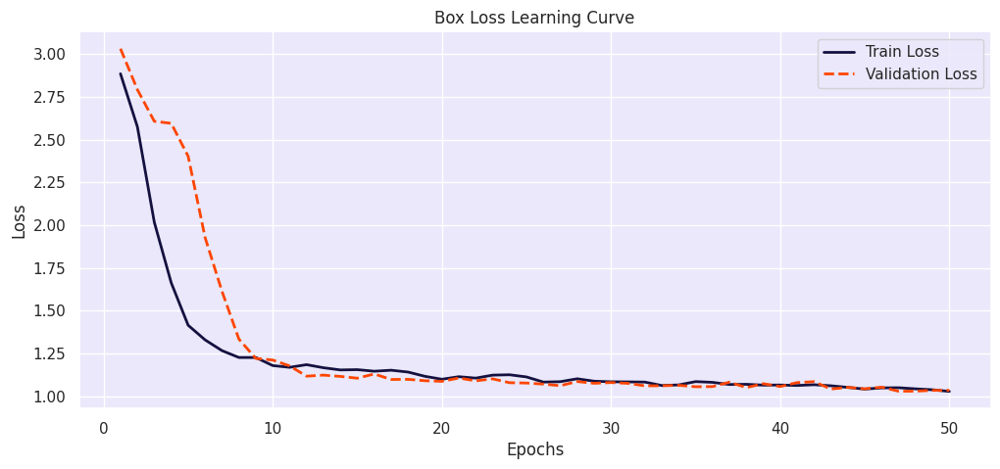

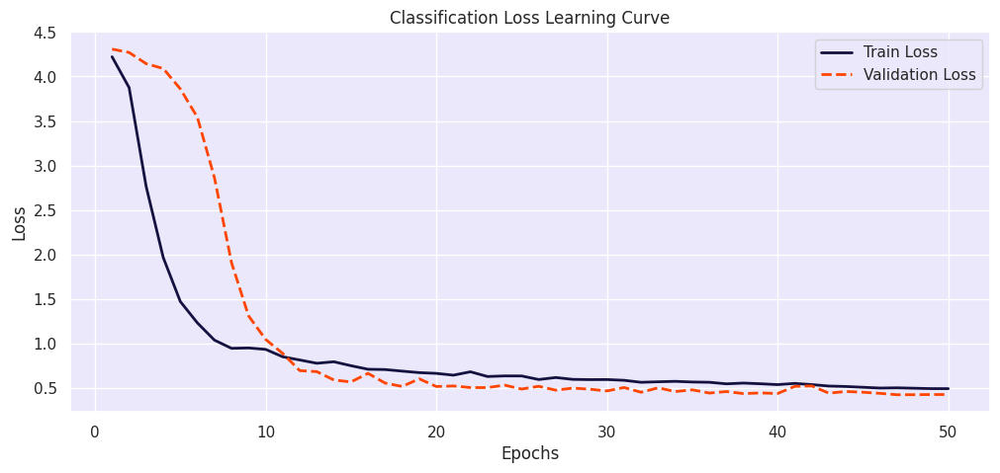

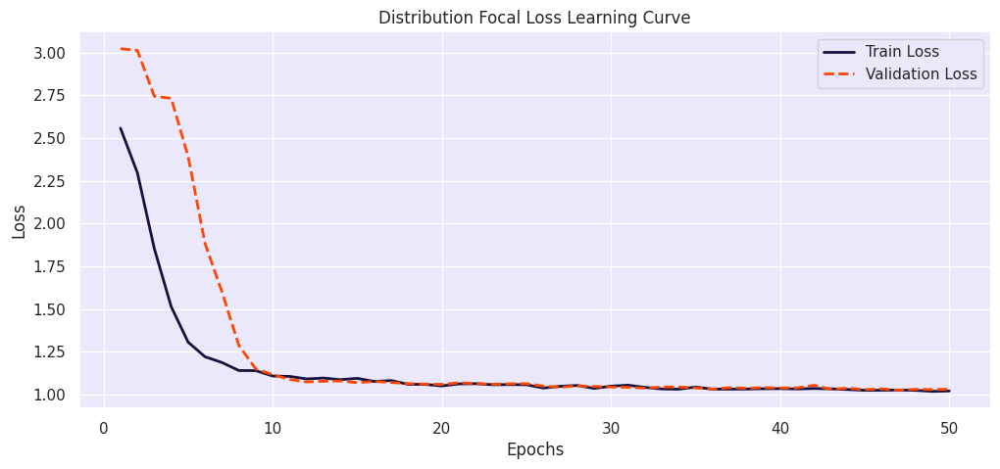

In [ ]:
# Create the full file path for 'results.csv' using the directory path and file name
results_csv_path = os.path.join(post_training_files_path, 'results.csv')

# Load the CSV file from the constructed path into a pandas DataFrame
df = pd.read_csv(results_csv_path)

# Remove any leading whitespace from the column names
df.columns = df.columns.str.strip()

# Plot the learning curves for each loss
plot_learning_curve(df, 'train/box_loss', 'val/box_loss', 'Box Loss Learning Curve')
plot_learning_curve(df, 'train/cls_loss', 'val/cls_loss', 'Classification Loss Learning Curve')
plot_learning_curve(df, 'train/dfl_loss', 'val/dfl_loss', 'Distribution Focal Loss Learning Curve')

#### **Step 5.2 | Confusion Matrix Evaluation**
Next, I will focus on displaying and meticulously analyzing the confusion matrix derived from our model's performance on the validation dataset:

#### **Validation Step**

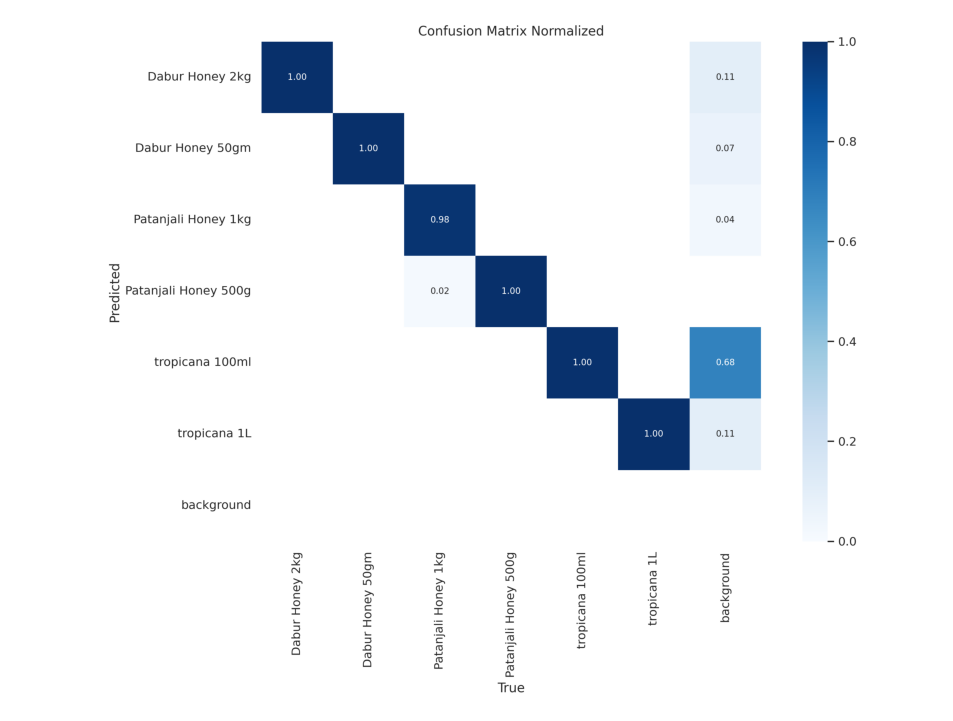

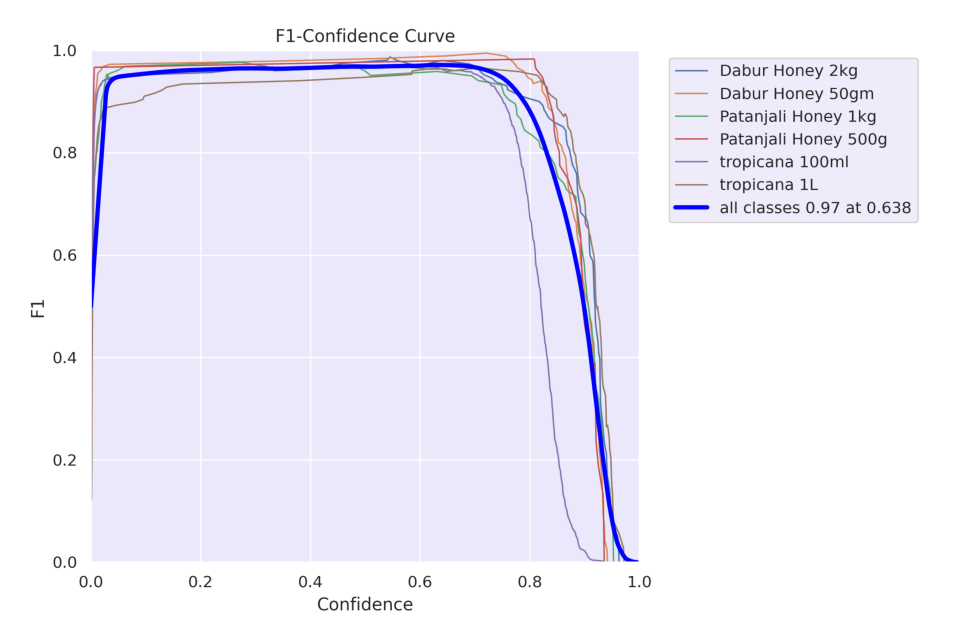

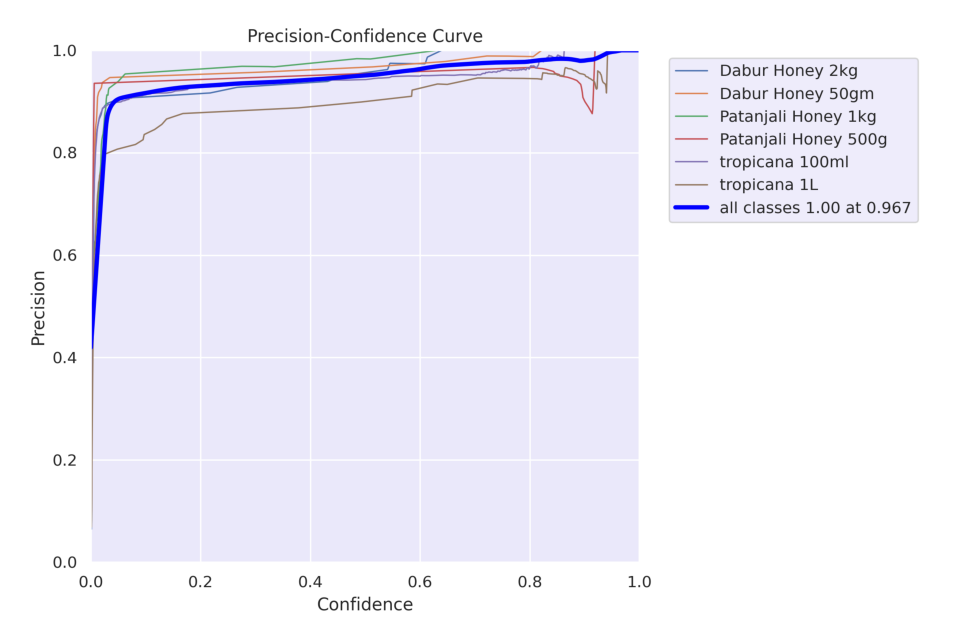

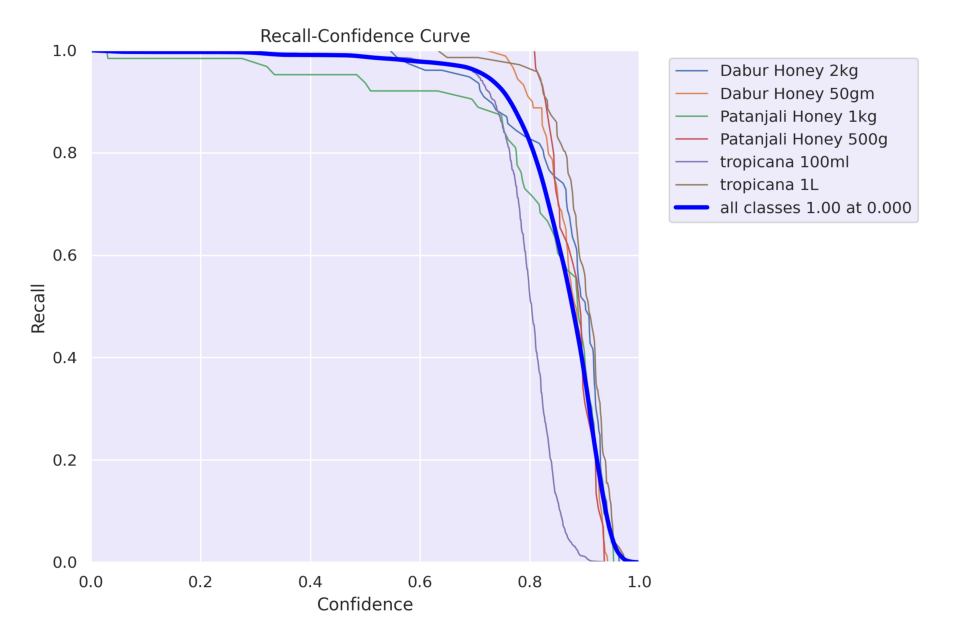

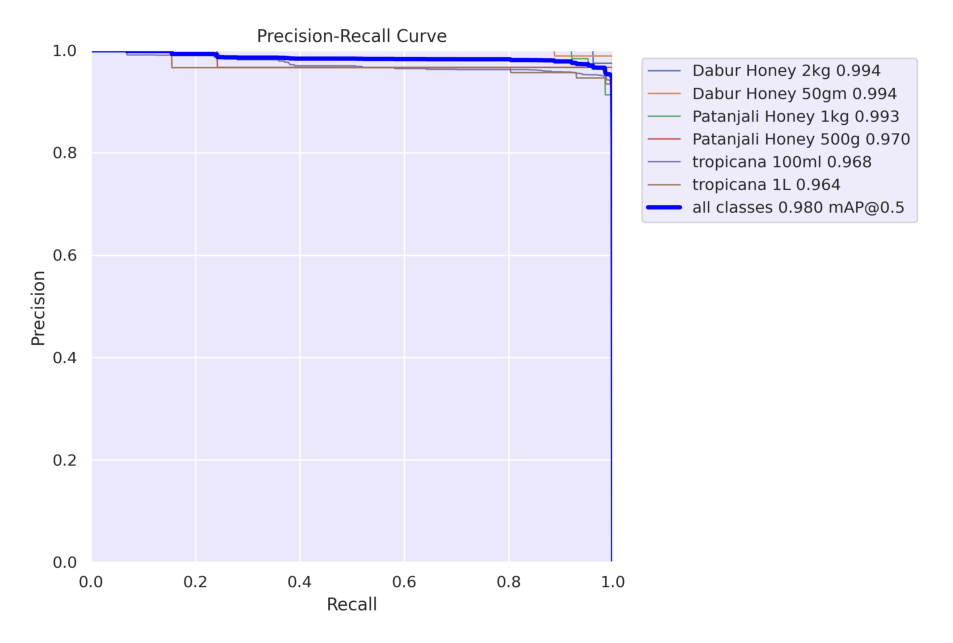

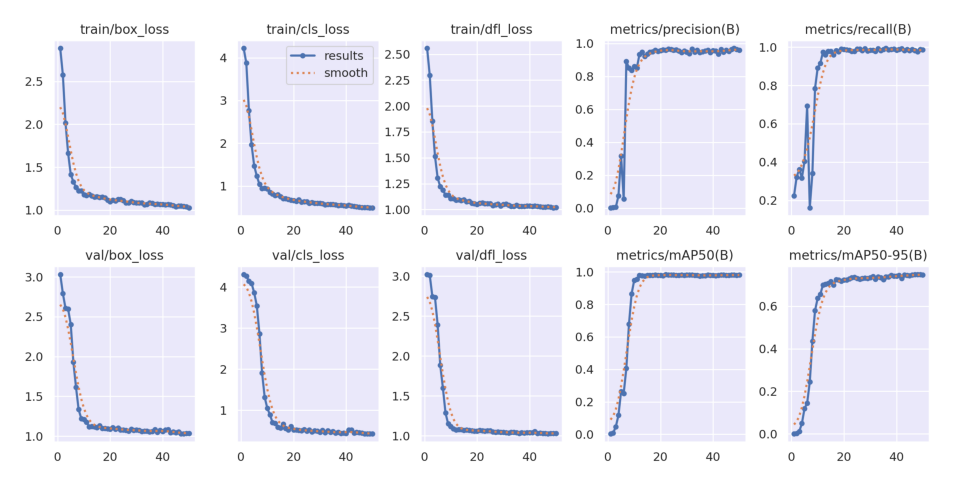

In [ ]:
import os
import cv2
import matplotlib.pyplot as plt

def display_images(post_training_files_path, image_files):

    for image_file in image_files:
        image_path = os.path.join(post_training_files_path, image_file)
        img = cv2.imread(image_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        plt.figure(figsize=(10, 10), dpi=120)
        plt.imshow(img)
        plt.axis('off')
        plt.show()

# List of image files to display
image_files = [
    'confusion_matrix_normalized.png',
    'F1_curve.png',
    'P_curve.png',
    'R_curve.png',
    'PR_curve.png',
    'results.png'
]

# Path to the directory containing the images
post_training_files_path = 'runs/detect/train'

# Display the images
display_images(post_training_files_path, image_files)

#### **Step 5.3 | Performance Metrics Assessment**
Finally, I am delving into various metrics to understand the model's predictive accuracy and areas of potential improvement:

In [ ]:
# Construct the path to the best model weights file using os.path.join
best_model_path = os.path.join(post_training_files_path, 'weights/best.pt')

# Load the best model weights into the YOLO model
best_model = YOLO(best_model_path)

# Validate the best model using the validation set with default parameters
metrics = best_model.val(split='val')

Ultralytics YOLOv8.2.74 🚀 Python-3.10.12 torch-2.3.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,006,818 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /content/drive/My Drive/grozzy/valid/labels.cache... 145 images, 1 backgrounds, 0 corrupt: 100%|██████████| 145/145 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [00:12<00:00,  1.27s/it]


                   all        145       1213       0.97      0.975       0.98      0.749
       Dabur Honey 2kg         57         77      0.998      0.961      0.994      0.821
      Dabur Honey 50gm         42         89      0.977          1      0.994      0.721
   Patanjali Honey 1kg         39         63          1      0.919      0.993      0.759
  Patanjali Honey 500g         29         29       0.96          1       0.97      0.787
       tropicana 100ml         54        884      0.951      0.976      0.968      0.656
          tropicana 1L         31         71      0.934      0.996      0.964       0.75
Speed: 1.2ms preprocess, 10.7ms inference, 0.1ms loss, 8.8ms postprocess per image
Results saved to runs/detect/val


In [ ]:
# Convert the dictionary to a pandas DataFrame and use the keys as the index
metrics_df = pd.DataFrame.from_dict(metrics.results_dict, orient='index', columns=['Metric Value'])

# Display the DataFrame
metrics_df.round(3)

<div class="alert alert-info" style="background-color:#0000FF; color:white; padding:0px 10px; border-radius:5px;">
    <h2 style='margin:10px 5px'> Step 6 | Model Inference & Generalization Assessment </h2>
</div>



To thoroughly assess our model's capability to generalize, I will conduct inferences in three distinct steps:

- Inference on Validation Set Images
- Inference on an Unseen Test Image
- Inference on an Unseen Test Video




#### **Step 6.1 | Inference on Validation Set Images**
First of all, I am going to evaluate model predictions on random images from the validation dataset:

In [ ]:
# Define the path to the validation images
valid_images_path = os.path.join(dataset_path, 'valid', 'images')

# List all jpg images in the directory
image_files = [file for file in os.listdir(valid_images_path) if file.endswith('.jpg')]

# Select 9 images at equal intervals
num_images = len(image_files)
selected_images = [image_files[i] for i in range(0, num_images, num_images // 9)]

# Initialize the subplot
fig, axes = plt.subplots(3, 3, figsize=(20, 21))
fig.suptitle('Validation Set Inferences', fontsize=24)

# Perform inference on each selected image and display it
for i, ax in enumerate(axes.flatten()):
    image_path = os.path.join(valid_images_path, selected_images[i])
    results = best_model.predict(source=image_path, imgsz=640, conf=0.5)
    annotated_image = results[0].plot(line_width=1)
    annotated_image_rgb = cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB)
    ax.imshow(annotated_image_rgb)
    ax.axis('off')

plt.tight_layout()
plt.show()

In [ ]:
Result_Final_model = pd.read_csv('runs/detect/train/results.csv')
Result_Final_model.tail(10)

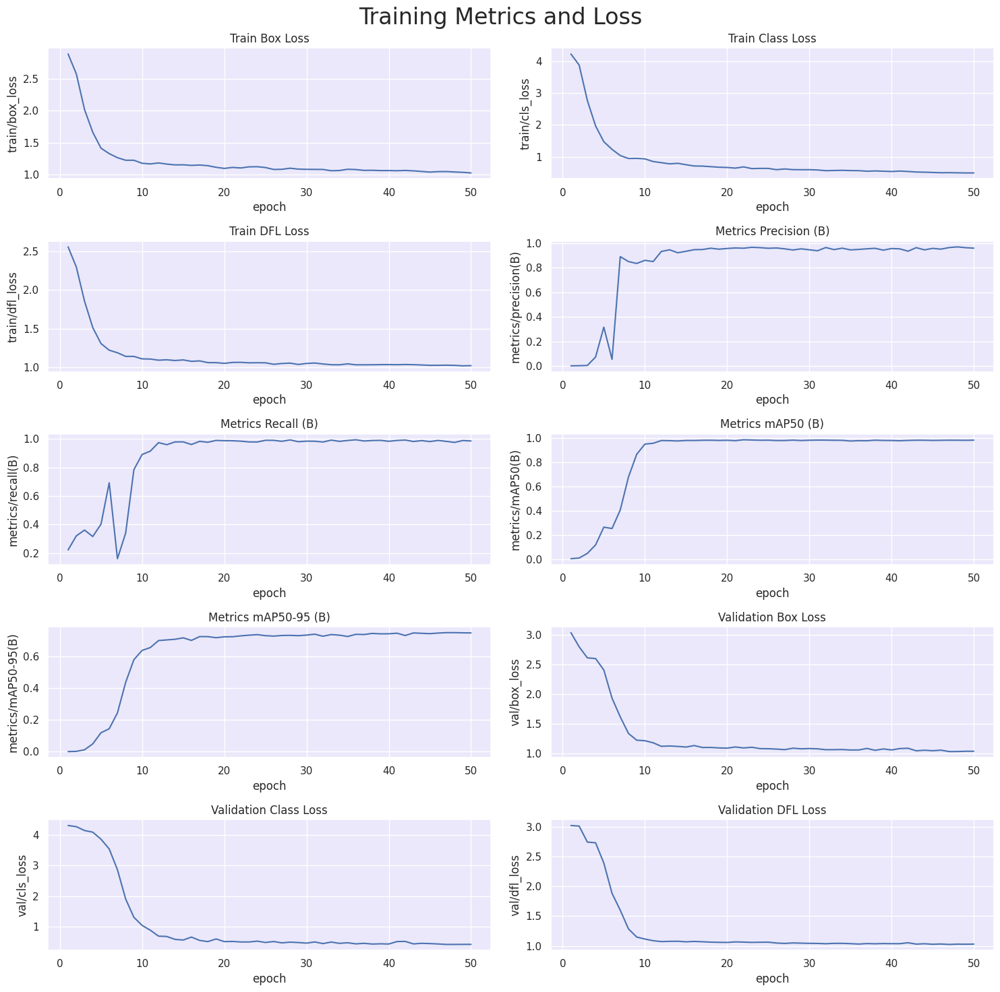

In [ ]:
# Read the results.csv file as a pandas dataframe
Result_Final_model.columns = Result_Final_model.columns.str.strip()

# Create subplots
fig, axs = plt.subplots(nrows=5, ncols=2, figsize=(15, 15))

# Plot the columns using seaborn
sns.lineplot(x='epoch', y='train/box_loss', data=Result_Final_model, ax=axs[0,0])
sns.lineplot(x='epoch', y='train/cls_loss', data=Result_Final_model, ax=axs[0,1])
sns.lineplot(x='epoch', y='train/dfl_loss', data=Result_Final_model, ax=axs[1,0])
sns.lineplot(x='epoch', y='metrics/precision(B)', data=Result_Final_model, ax=axs[1,1])
sns.lineplot(x='epoch', y='metrics/recall(B)', data=Result_Final_model, ax=axs[2,0])
sns.lineplot(x='epoch', y='metrics/mAP50(B)', data=Result_Final_model, ax=axs[2,1])
sns.lineplot(x='epoch', y='metrics/mAP50-95(B)', data=Result_Final_model, ax=axs[3,0])
sns.lineplot(x='epoch', y='val/box_loss', data=Result_Final_model, ax=axs[3,1])
sns.lineplot(x='epoch', y='val/cls_loss', data=Result_Final_model, ax=axs[4,0])
sns.lineplot(x='epoch', y='val/dfl_loss', data=Result_Final_model, ax=axs[4,1])

# Set titles and axis labels for each subplot
axs[0,0].set(title='Train Box Loss')
axs[0,1].set(title='Train Class Loss')
axs[1,0].set(title='Train DFL Loss')
axs[1,1].set(title='Metrics Precision (B)')
axs[2,0].set(title='Metrics Recall (B)')
axs[2,1].set(title='Metrics mAP50 (B)')
axs[3,0].set(title='Metrics mAP50-95 (B)')
axs[3,1].set(title='Validation Box Loss')
axs[4,0].set(title='Validation Class Loss')
axs[4,1].set(title='Validation DFL Loss')


plt.suptitle('Training Metrics and Loss', fontsize=24)
plt.subplots_adjust(top=0.8)
plt.tight_layout()
plt.show()

#### **Step 6.2 | Inference on an Unseen Test Images**
Now, I will employ the best version of our fine-tuned model to evaluate its generalization capabilities. I'll test it on the same image previously analyzed using the pre-trained YOLOv8 model on the COCO dataset:


image 1/1 /content/drive/My Drive/grozzy/test/images/image3_jpg.rf.161d42a2bbe547584de86c171ffc15d8.jpg: 640x640 2 Dabur Honey 50gms, 7.7ms
Speed: 1.8ms preprocess, 7.7ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /content/drive/My Drive/grozzy/test/images/image7_jpg.rf.8adcedc804c882b978f78964c9af6ee8.jpg: 640x640 1 Patanjali Honey 1kg, 7.5ms
Speed: 1.8ms preprocess, 7.5ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /content/drive/My Drive/grozzy/test/images/image165_jpg.rf.52f5d3854d0681c37cea3c29f7134a02.jpg: 640x640 1 Dabur Honey 2kg, 2 Patanjali Honey 1kgs, 1 Patanjali Honey 500g, 7.3ms
Speed: 1.7ms preprocess, 7.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /content/drive/My Drive/grozzy/test/images/image39_jpg.rf.2539c6d4e90154dcd09ceeeb9f822f99.jpg: 640x640 1 Dabur Honey 2kg, 2 Dabur Honey 50gms, 7.3ms
Speed: 2.2ms preprocess, 7.3ms inference, 1.3ms postprocess per image at shape

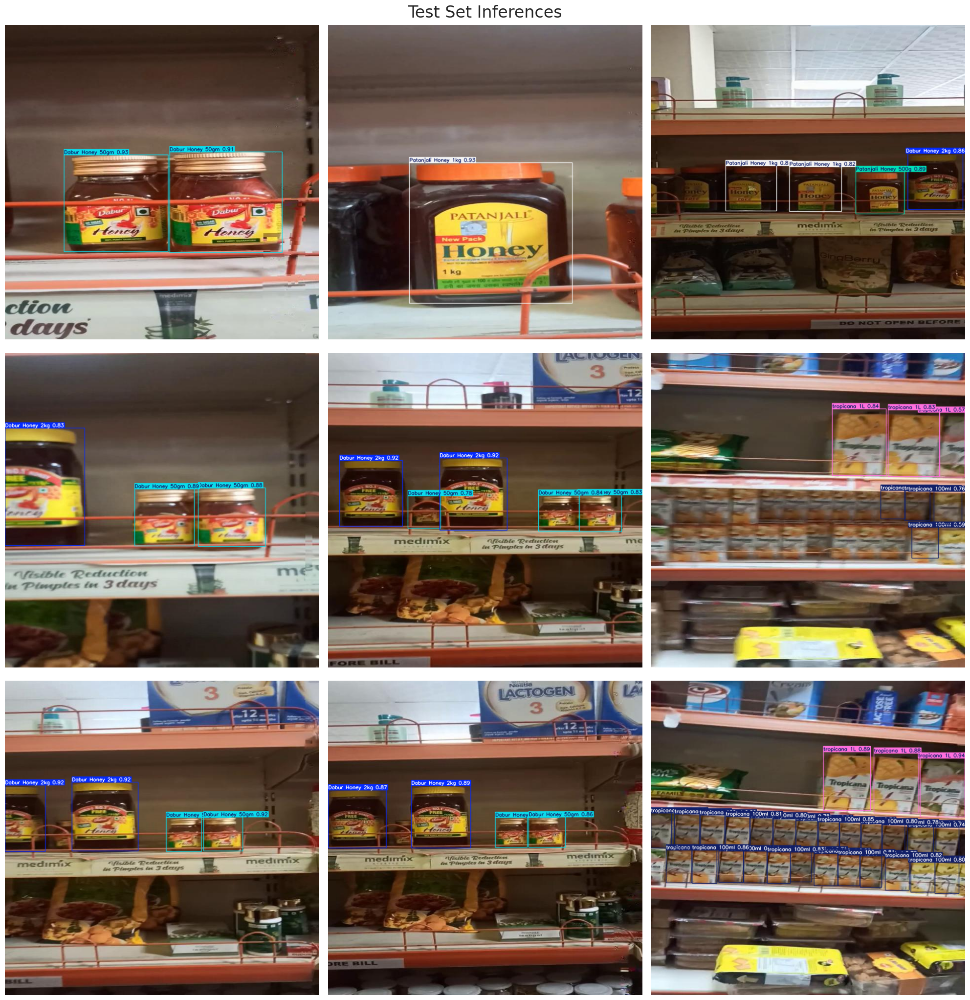

In [ ]:
# Define the path to the validation images
test_images_path = os.path.join(dataset_path, 'test', 'images')

# List all jpg images in the directory
image_files = [file for file in os.listdir(test_images_path) if file.endswith('.jpg')]

# Select 9 images at equal intervals
num_images = len(image_files)
selected_images = [image_files[i] for i in range(0, num_images, num_images // 9)]

# Initialize the subplot
fig, axes = plt.subplots(3, 3, figsize=(20, 21))
fig.suptitle('Test Set Inferences', fontsize=24)

# Perform inference on each selected image and display it
for i, ax in enumerate(axes.flatten()):
    image_path = os.path.join(test_images_path, selected_images[i])
    results = best_model.predict(source=image_path, imgsz=640, conf=0.5)
    annotated_image = results[0].plot(line_width=1)
    annotated_image_rgb = cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB)
    ax.imshow(annotated_image_rgb)
    ax.axis('off')

plt.tight_layout()
plt.show()

In [ ]:
# Loading the best performing model
Valid_model = YOLO('runs/detect/train/weights/best.pt')

# Evaluating the model on the validset
results = Valid_model.val(split = 'val')

# Accessing the metrics
#metrics = results.metrics
metrics_dict = results.results_dict

# final results
print("precision(B): ", metrics.results_dict["metrics/precision(B)"])
print("metrics/recall(B): ", metrics.results_dict["metrics/recall(B)"])
print("metrics/mAP50(B): ", metrics.results_dict["metrics/mAP50(B)"])
print("metrics/mAP50-95(B): ", metrics.results_dict["metrics/mAP50-95(B)"])

#### **Step 6.2 | Inference on an Unseen Test Image**
Now, I will employ the best version of our fine-tuned model to evaluate its generalization capabilities. I'll test it on the same image previously analyzed using the pre-trained YOLOv8 model on the COCO dataset:

In [ ]:
# Path to the image file
sample_image_path = "/content/drive/My Drive/grozzy/sample_image.jpg"

# Perform inference on the provided image using best model
results = best_model.predict(source=sample_image_path, imgsz=640, conf=0.7)

# Annotate and convert image to numpy array
sample_image = results[0].plot(line_width=2)

# Convert the color of the image from BGR to RGB for correct color representation in matplotlib
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)

# Display annotated image
plt.figure(figsize=(20,15))
plt.imshow(sample_image)
plt.title('Detected Objects in Sample Image by the Fine-tuned YOLOv8 Model', fontsize=20)
plt.axis('off')
plt.show()

Making Predictions On Test Images
#### **Step 6.3 | Inference on an Unseen Test Images**
Now, we will employ the best version of our fine-tuned model to evaluate its generalization capabilities. We'll test it on the test set:


0: 640x640 2 Dabur Honey 50gms, 7.6ms
Speed: 2.7ms preprocess, 7.6ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 Patanjali Honey 1kg, 11.1ms
Speed: 3.6ms preprocess, 11.1ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 Dabur Honey 2kg, 2 Patanjali Honey 1kgs, 1 Patanjali Honey 500g, 8.6ms
Speed: 3.7ms preprocess, 8.6ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 Dabur Honey 2kg, 2 Dabur Honey 50gms, 10.0ms
Speed: 3.5ms preprocess, 10.0ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 Dabur Honey 2kgs, 3 Dabur Honey 50gms, 8.4ms
Speed: 3.9ms preprocess, 8.4ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 4 tropicana 100mls, 3 tropicana 1Ls, 10.7ms
Speed: 3.6ms preprocess, 10.7ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 2 Dabur Honey 2kgs, 2 Dabur Honey 50gms, 8.7ms
Speed: 3.6ms preproces

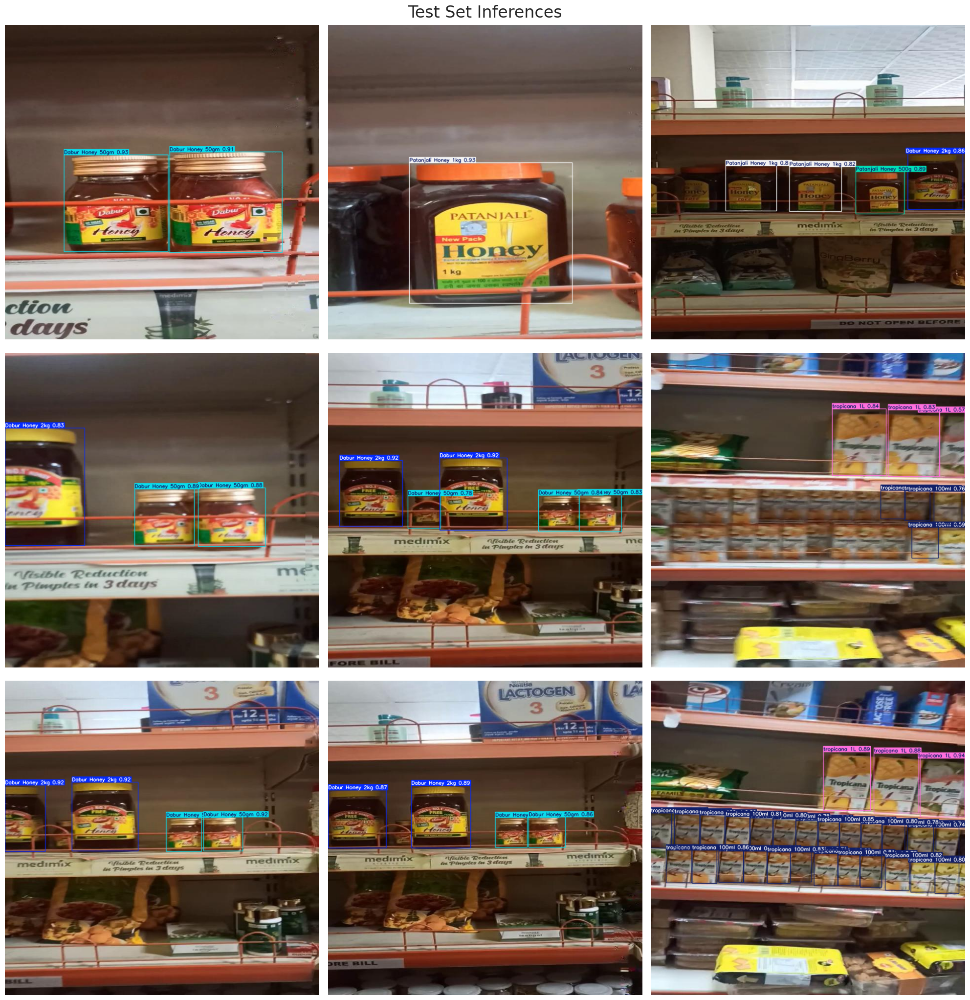

In [ ]:
# Normalization function
def normalize_image(image):
    return image / 255.0

# Image resizing function
def resize_image(image, size=(640, 640)):
    return cv2.resize(image, size)

# Path to validation images
dataset_path = "/content/drive/My Drive/grozzy"  # Place your dataset path here
valid_images_path = os.path.join(dataset_path, 'test', 'images')

# List of all jpg images in the directory
image_files = [file for file in os.listdir(valid_images_path) if file.endswith('.jpg')]

# Check if there are images in the directory
if len(image_files) > 0:
    # Select 9 images at equal intervals
    num_images = len(image_files)
    step_size = max(1, num_images // 9)  # Ensure the interval is at least 1
    selected_images = [image_files[i] for i in range(0, num_images, step_size)]

    # Prepare subplots
    fig, axes = plt.subplots(3, 3, figsize=(20, 21))
    fig.suptitle('Test Set Inferences', fontsize=24)

    for i, ax in enumerate(axes.flatten()):
        if i < len(selected_images):
            image_path = os.path.join(valid_images_path, selected_images[i])

            # Load image
            image = cv2.imread(image_path)

            # Check if the image is loaded correctly
            if image is not None:
                # Resize image
                resized_image = resize_image(image, size=(640, 640))
                # Normalize image
                normalized_image = normalize_image(resized_image)

                # Convert the normalized image to uint8 data type
                normalized_image_uint8 = (normalized_image * 255).astype(np.uint8)

                # Predict with the model
                results = Valid_model.predict(source=normalized_image_uint8, imgsz=640, conf=0.5)

                # Plot image with labels
                annotated_image = results[0].plot(line_width=1)
                annotated_image_rgb = cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB)
                ax.imshow(annotated_image_rgb)
            else:
                print(f"Failed to load image {image_path}")
        ax.axis('off')

    plt.tight_layout()
    plt.show()